<a href="https://colab.research.google.com/github/NalaHam/07-02-2022/blob/main/notebooks2025/Lecture6_SpatialTranscriptomics_ImageManip.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# This notebook will go through integrating/concatenating datasets and basic annotations including cell typing.

<a href="https://colab.research.google.com/github/Ken-Lau-Lab/single-cell-lectures/blob/main/notebooks2025/Lecture6_SpatialTranscriptomics_ImageManip.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Installation of Packages

In [1]:
!pip install matplotlib==3.7.5
#==3.6.2

In [2]:
!pip install scanpy==1.10.1
!pip install pandas==2.2.2
!pip install numpy==1.26.4

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 28.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.7/142.7 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.6/83.6 kB 6.3 MB/s eta 0:00:00
  Created wheel for session-info: filename=session_info-1.0.0-py3-none-any.whl size=8023 sha256=80f27f5bc3abb844c6d540e940cfea2a7e12dc73cb3527bb099f7d9fd167d7b1
  Stored in directory: /root/.cache/pip/wheels/4e/56/35/a748fc57279a4b84d0b332879445fed1ad8478e7257986b015
Successfully built session-info


In [3]:
!pip install anndata

In [4]:
!pip install leidenalg

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 21.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 30.2 MB/s eta 0:00:00


## Import packages

In [24]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
import anndata as ad

# Reading in and initial data processing

In [6]:
#Downloads the data from online
dat = sc.datasets.visium_sge(sample_id="V1_Human_Lymph_Node")

  0%|          | 0.00/7.86M [00:00<?, ?B/s]

  0%|          | 0.00/29.3M [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/lib/python3.11/dist-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [7]:
dat.var_names_make_unique() #makes variables unique in the data
dat.var["mt"] = dat.var_names.str.startswith("MT-") #identifies the mitochondrial genes
sc.pp.calculate_qc_metrics(dat, qc_vars=["mt"], inplace=True) #calculates the classic qc metrics

In [8]:
dat

AnnData object with n_obs × n_vars = 4035 × 36601
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'spatial'
    obsm: 'spatial'

In [9]:
sc.pp.filter_cells(dat, min_counts=5000) #filters minimum and maximum gene count info
sc.pp.filter_cells(dat, max_counts=35000)
dat = dat[dat.obs["pct_counts_mt"] < 20].copy()
print(f"#cells after MT filter: {dat.n_obs}")
sc.pp.filter_genes(dat, min_cells=10)

#cells after MT filter: 3861


In [10]:
sc.pp.normalize_total(dat, inplace=True) #normalize
sc.pp.log1p(dat) #log transform
sc.pp.highly_variable_genes(dat, flavor="seurat", n_top_genes=2000)

In [11]:
sc.pp.pca(dat)
sc.pp.neighbors(dat)
sc.tl.umap(dat)
sc.tl.leiden(dat, key_added="clusters", flavor="igraph", directed=False, n_iterations=2)

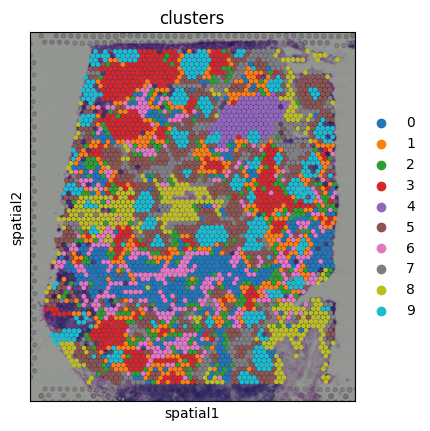

In [12]:
sc.pl.spatial(dat, img_key="hires", color="clusters", size=1.5)

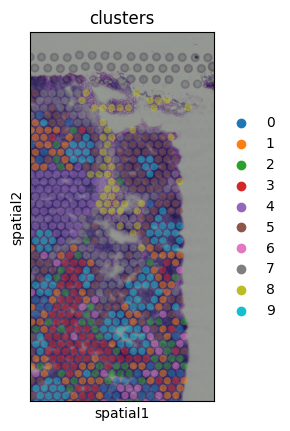

In [13]:
sc.pl.spatial(dat, img_key = 'hires', color = 'clusters', crop_coord = [7000, 10000, 0, 6000], alpha = 0.5, size = 1.3)

The highest expressed gene is: IGKC


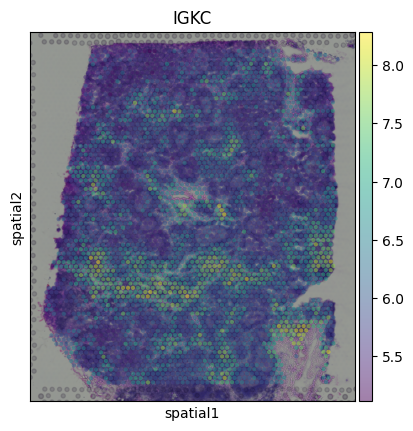

In [62]:
# Step 1: Identify the highest expressed gene
# Calculate the mean expression of each gene across all cells
mean_expression = np.mean(dat.X, axis=0)

# Find the index of the highest expressed gene
highest_expressed_gene_index = np.argmax(mean_expression)

# Get the name of the highest expressed gene
highest_expressed_gene = dat.var_names[highest_expressed_gene_index]

print(f"The highest expressed gene is: {highest_expressed_gene}")

# Step 2: Create a spatial plot with the highest expressed gene overlaid
sc.pl.spatial(dat, img_key='hires', color=highest_expressed_gene, alpha=0.5, size=1.3)

In [27]:
dat_subset = dat[dat.obs['clusters'].isin([3, 8, 9])]

In [55]:
mask = dat[dat.obs['clusters'].isin(['3', '8', '9'])].copy()

In [44]:
dat

AnnData object with n_obs × n_vars = 3861 × 19685
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'clusters'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'clusters', 'clusters_colors'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

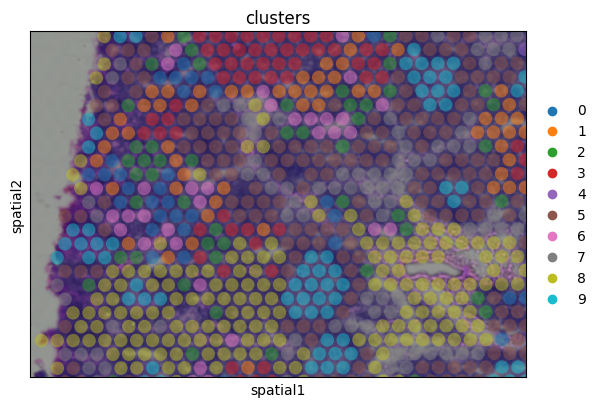

In [47]:
sc.pl.spatial(dat, img_key = 'hires', color = 'clusters', crop_coord = [1700, 6000, 3000, 6000], alpha = 0.5, size = 1.3)

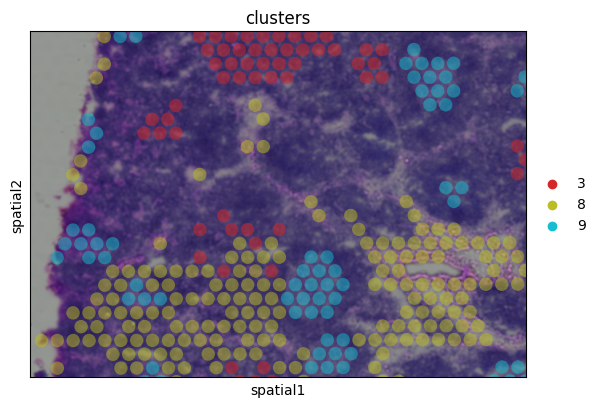

In [57]:
sc.pl.spatial(dat[dat.obs['clusters'].isin(['3', '8', '9'])].copy(), img_key = 'hires', color = 'clusters', crop_coord = [1700, 6000, 3000, 6000], alpha = 0.5, size = 1.3)

#Importing Images into Python

In [14]:
!curl -O -J -L https://www.dropbox.com/scl/fi/ch89ctvzmlkxp1lpwi63k/Homework6.png?rlkey=rud80ipa4mmfj2ssmvvkplh6i&dl=0

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100    17  100    17    0     0     19      0 --:--:-- --:--:-- --:--:--    19
100 10.0M  100 10.0M    0     0  6384k      0  0:00:01  0:00:01 --:--:-- 86.8M


In [15]:
!pip install opencv-python

In [16]:
from google.colab.patches import cv2_imshow
import cv2    #for non-Colab

In [17]:
#read in image file
img = cv2.imread('Homework6.png')

In [18]:
#Shrink image size - keep this the same for colab, original image very large scale
resized_image = cv2.resize(img, (500,500))

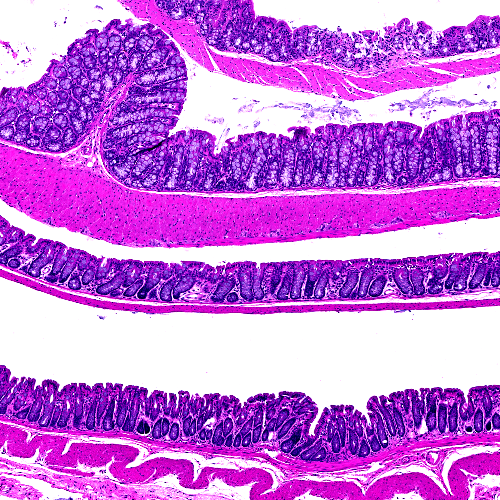

In [19]:
cv2_imshow(resized_image)
#cv2.imshow()    #for non-Colab - will crash Colab kernal

In [58]:
#Rotate the image
rot_image = cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)

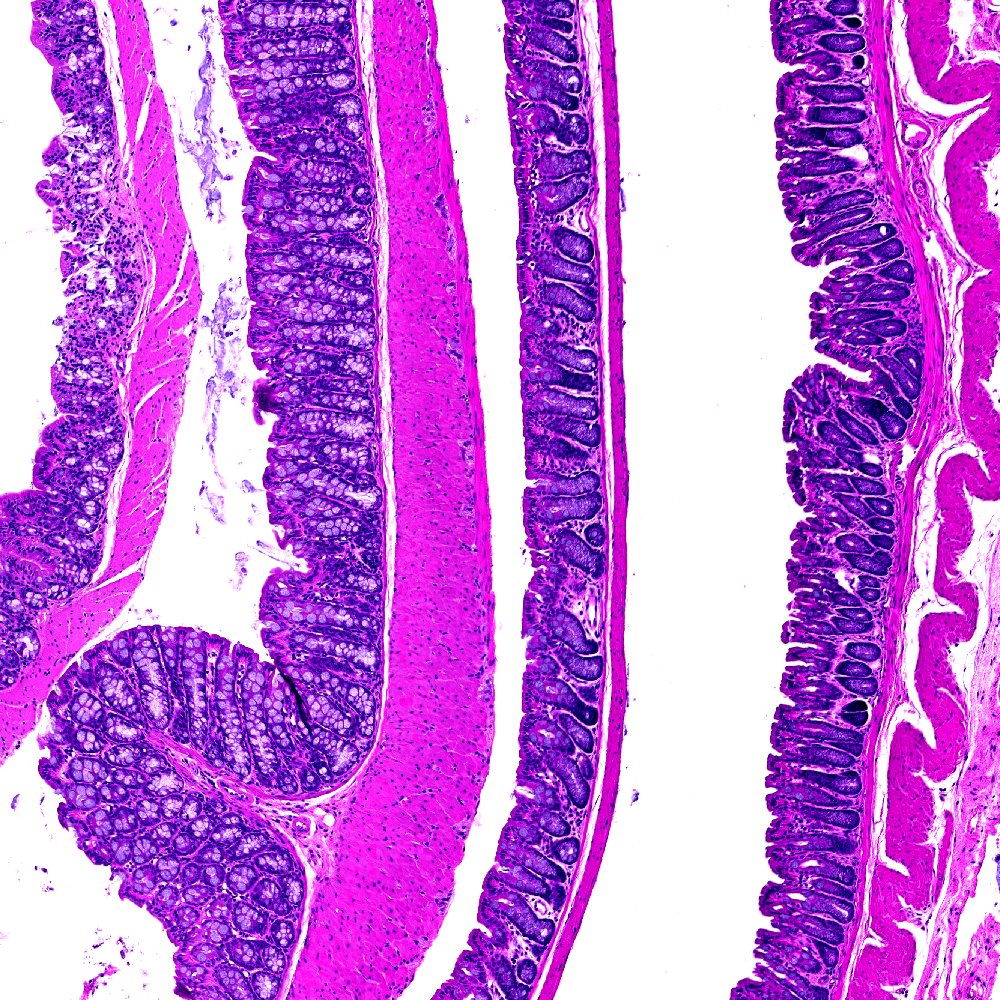

In [59]:
cv2_imshow(rot_image)

In [60]:
#convert the image to a different color
color_img = cv2.cvtColor(rot_image, cv2.COLOR_BGR2YCrCb)

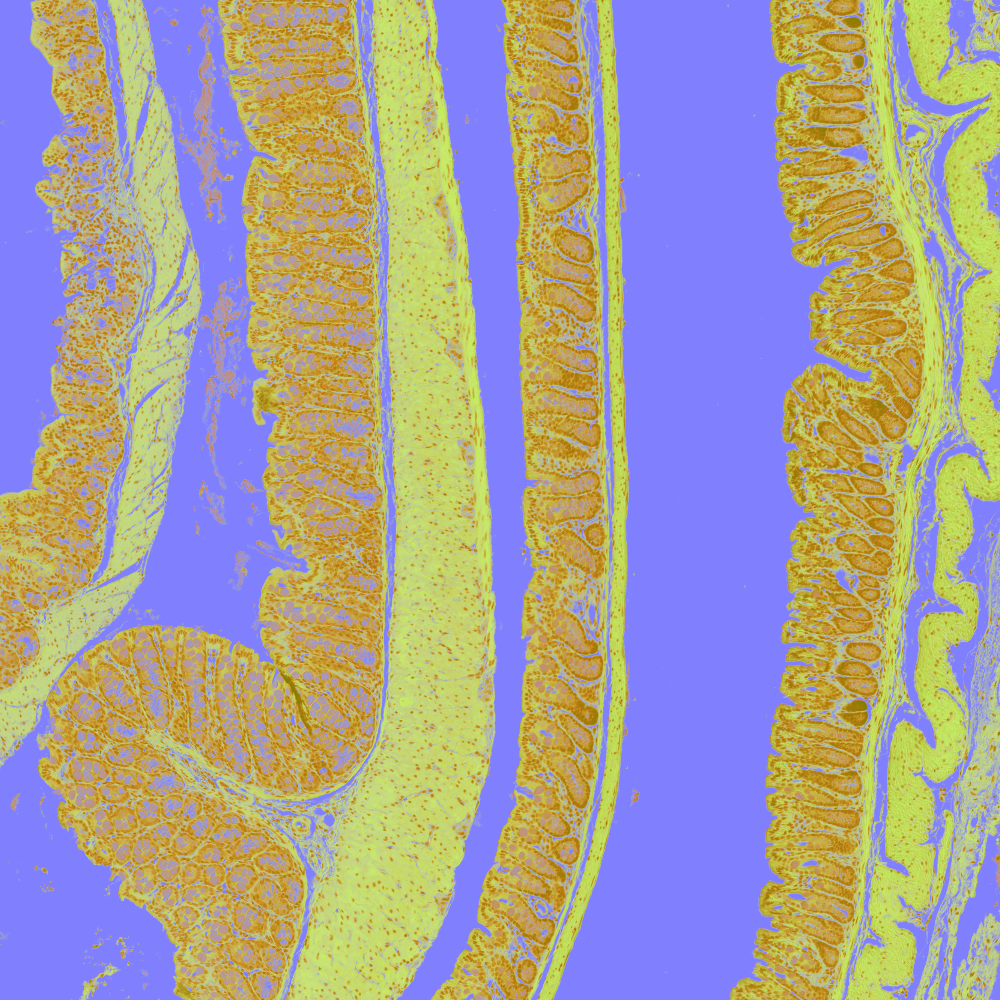

In [61]:
cv2_imshow(color_img)